In [1]:
import numpy as np
from sklearn.datasets import make_classification
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.svm import NuSVC

np.random.seed(0)

import os
os.add_dll_directory('C:\Aorda\PSG\lib')
import psgpython as psg
from psgutilities import *

In [2]:
numPointsPerCluster = 500

In [3]:
def gen_data():
  # Define coordinates for the vertices of the triangle
  vertices = np.array([[-10, 0], [10, 0], [0, 16]])

  # numPointsPerCluster = 500

  # Class -1: Generate data points in the first cluster (triangle vertex 1)
  mean_class_minus = vertices[0]
  cov_class_minus = [[1, 0], [0, 1]]
  class_minus = np.random.multivariate_normal(mean_class_minus, cov_class_minus, numPointsPerCluster)

  # Class 0: Generate data points in the second cluster (triangle vertex 2)
  mean_class_zero = vertices[1]
  cov_class_zero = [[1, 0], [0, 1]]
  class_zero = np.random.multivariate_normal(mean_class_zero, cov_class_zero, numPointsPerCluster)

  # Class +1: Generate data points in the third cluster (triangle vertex 3)
  mean_class_plus = vertices[2]
  cov_class_plus = [[1, 0], [0, 1]]
  class_plus = np.random.multivariate_normal(mean_class_plus, cov_class_plus, numPointsPerCluster)

  # Combine the clusters
  X = np.vstack((class_minus, class_zero, class_plus))

  # Create the three datasets with rotating labels
  y1 = np.hstack((np.ones(numPointsPerCluster), np.ones(numPointsPerCluster) * -1, np.zeros(numPointsPerCluster)))
  y2 = np.hstack((np.zeros(numPointsPerCluster), np.ones(numPointsPerCluster), np.ones(numPointsPerCluster) * -1))
  y3 = np.hstack((np.ones(numPointsPerCluster) * -1, np.zeros(numPointsPerCluster), np.ones(numPointsPerCluster)))


  X1, X2, X3 = X.copy(), X.copy(), X.copy()

  # Plot the clusters with different colors for each dataset
  # plt.figure(figsize=(10, 3))
  # plt.subplot(131)
  # plt.scatter(X1[:, 0], X1[:, 1], c=y1, cmap=plt.cm.Paired)
  # plt.title('Dataset 1')
  # plt.subplot(132)
  # plt.scatter(X2[:, 0], X2[:, 1], c=y2, cmap=plt.cm.Paired)
  # plt.title('Dataset 2')
  # plt.subplot(133)
  # plt.scatter(X3[:, 0], X3[:, 1], c=y3, cmap=plt.cm.Paired)
  # plt.title('Dataset 3')
  # plt.show()

  # store for cluster coloring purpose
  # labels_cluster1 = np.ones(numPointsPerCluster)
  # labels_cluster2 = 2 * np.ones(numPointsPerCluster)
  # labels_cluster3 = 3 * np.ones(numPointsPerCluster)
  # origX = X1
  # colorX = np.hstack((labels_cluster1, labels_cluster2, labels_cluster3))
  # plt.figure(figsize=(10, 3))

  # plt.subplot(133)
  # plt.scatter(origX[:, 0], origX[:, 1], c=y1, cmap=plt.cm.Paired)
  # plt.title('Dataset 3')
  # plt.show()

  # Return the datasets
  return [X1, X2, X3], [y1, y2, y3]

In [4]:
import sys
import numpy
numpy.set_printoptions(threshold=sys.maxsize)

In [5]:
def min_bpoe(X, y, a, x, solver, DIMS, initial_w=None):
  # multiply each y1 vector a1 scalar (etc. for y2, a2)
  y = [y[i] * a[i] for i in range(DIMS)]
  # print(f"y * a:\n{y}")
  
  # Combine X columns into one matrix
  X = np.hstack((X[i] for i in range(DIMS)))
  # print(f"X Stacked:\n{X}")

  # add column of 1s to X matrix
  extra_column = np.ones((len(X), DIMS))
  X = np.hstack((X, extra_column))
  # print(f"X with 1s:\n{X}")


  # multiply each of the y columns by the respective X columns
  cols_to_multiply1 = X[:, [0, 1, 6]]
  cols_to_multiply2 = X[:, [2, 3, 7]]
  cols_to_multiply3 = X[:, [4, 5, 8]]

  result1 = cols_to_multiply1 * y[0].reshape(-1, 1)
  result2 = cols_to_multiply2 * y[1].reshape(-1, 1)
  result3 = cols_to_multiply3 * y[2].reshape(-1, 1)

  bpoe_matrix_scenarios_body = np.hstack((result1, result2, result3))
  # print(f"X * y:\n{bpoe_matrix_scenarios_body}")


  # add benchmark column
  bpoe_scenario_benchmark = np.array([a @ x] * len(bpoe_matrix_scenarios_body))
  # print(f"benchmark:\n{bpoe_scenario_benchmark}")

  # for i in range(len(bpoe_matrix_scenarios_body)):
  #   count_zeros = np.sum(bpoe_matrix_scenarios_body[i] == 0)  # Count the number of zeros in the ith row
  #   if count_zeros in [3, 6]:
  #       bpoe_scenario_benchmark[i] = 0
  # print(f"benchmark remove zeroes:\n{bpoe_scenario_benchmark}")
  
  bpoe_matrix_scenarios_body = np.column_stack((bpoe_matrix_scenarios_body, bpoe_scenario_benchmark))
  # print(f"bpoe_matrix_scenarios_body:\n{bpoe_matrix_scenarios_body}")

  bpoe_matrix_scenarios_body = np.asarray(bpoe_matrix_scenarios_body, order='C')

  bpoe_header = ['w11', 'w12', 'b1', 'w21', 'w22', 'b2', 'w31', 'w32', 'b3']
  bpoe_matrix_scenarios = [bpoe_header+['scenario_benchmark'], bpoe_matrix_scenarios_body]

  bpoe_matrix_quadratic1_body = np.asarray([[1, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 1, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0]], order='C')
  bpoe_matrix_quadratic2_body = np.asarray([[0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 1, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 1, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0]], order='C')
  bpoe_matrix_quadratic3_body = np.asarray([[0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 1, 0, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 1, 0],
                                            [0, 0, 0, 0, 0, 0, 0, 0, 0]], order='C')
  bpoe_matrix_quadratic1 = [bpoe_header, bpoe_matrix_quadratic1_body]
  bpoe_matrix_quadratic2 = [bpoe_header, bpoe_matrix_quadratic2_body]
  bpoe_matrix_quadratic3 = [bpoe_header, bpoe_matrix_quadratic3_body]

  allowExternal = True
  suppressMessages = False
  bpoe_problem_name = "problem_classify"
  bpoe_problem_statement = f"minimize\n\
  bpoe({0},matrix_scenarios)\n\
  Constraint: <= 1\n\
  quadratic(matrix_quadratic1)\n\
  Constraint: <= 1\n\
  quadratic(matrix_quadratic2)\n\
  Constraint: <= 1\n\
  quadratic(matrix_quadratic3)\n\
  Box: >= -10, <= 10\n\
  Solver: {solver}"
  bpoe_problem_dictionary = {'problem_name':bpoe_problem_name, 
                             'problem_statement':bpoe_problem_statement, 
                             'matrix_scenarios':bpoe_matrix_scenarios, 
                             'matrix_quadratic1':bpoe_matrix_quadratic1, 
                             'matrix_quadratic2':bpoe_matrix_quadratic2,
                             'matrix_quadratic3':bpoe_matrix_quadratic3}
  # if an initial point estimate is provided use it
  if(initial_w is not None):
    bpoe_problem_statement = f"minimize\n\
    bpoe({0},matrix_scenarios)\n\
    Constraint: <= 1\n\
    quadratic(matrix_quadratic1)\n\
    Constraint: <= 1\n\
    quadratic(matrix_quadratic2)\n\
    Constraint: <= 1\n\
    quadratic(matrix_quadratic3)\n\
    Box: >= -10, <= 10\n\
    Solver: {solver}, init_point = point_initial_w"
    bpoe_problem_dictionary['point_initial_w'] = [bpoe_header, np.asarray(initial_w, order='C')]

  bpoe_res = psg.psg_solver(bpoe_problem_dictionary, allowExternal, suppressMessages)
  print(f"{bpoe_problem_name} Result:\n{bpoe_res}")
  print(f"{bpoe_problem_name} Optimal Point:\n{get_optimalpoint(bpoe_res)}")
  print(f"{bpoe_problem_name} Objective:\n{get_objective(bpoe_res)}")

  return (get_optimalpoint(bpoe_res), get_objective(bpoe_res))

In [6]:
def min_pm(X, y, w, x, solver, DIMS, initial_a=None):
  # unpack
  w11, w12, b1, w21, w22, b2, w31, w32, b3 = w
  X1, X2, X3 = X
  y1, y2, y3 = y

  # multiply columns of X by their respective w_ij, sum the columns horizontally, and add b_j
  X1[:, 0] *= w11
  X1[:, 1] *= w12
  X1 = np.sum(X1, axis=1) + b1
  X1 = x[0] - (y1 * X1)

  X2[:, 0] *= w21
  X2[:, 1] *= w22
  X2 = np.sum(X2, axis=1) + b2
  X2 = x[1] - (y2 * X2)

  X3[:, 0] *= w31
  X3[:, 1] *= w32
  X3 = np.sum(X3, axis=1) + b3
  X3 = x[2] - (y3 * X3)

  pm_matrix_scenarios_body = np.column_stack((X1, X2, X3))
  pm_matrix_scenarios_body = np.asarray(pm_matrix_scenarios_body, order='C')
  pm_header = ['a1', 'a2', 'a3']
  pm_matrix_scenarios = [pm_header, pm_matrix_scenarios_body]
  pm_matrix_linear_body = np.asarray([1, 1, 1], order='C')
  pm_matrix_linear = [pm_header, pm_matrix_linear_body]

  allowExternal = True
  suppressMessages = False
  pm_problem_name = "problem_classify"
  pm_problem_statement = f"minimize\n\
  pm_pen({-1},matrix_scenarios)\n\
  Constraint: == 3\n\
  linear(matrix_linear)\n\
  Box: >= 0\n\
  Solver: {solver}"
  pm_problem_dictionary = {'problem_name':pm_problem_name, 
                             'problem_statement':pm_problem_statement, 
                             'matrix_scenarios':pm_matrix_scenarios,
                             'matrix_linear':pm_matrix_linear}
  # if initial point estimate is provided use it
  if(initial_a is not None):
    pm_problem_statement = f"minimize\n\
    pm_pen({-1},matrix_scenarios)\n\
    Constraint: == 3\n\
    linear(matrix_linear)\n\
    Box: >= 0\n\
    Solver: {solver}, init_point = point_initial_a"
    pm_problem_dictionary['point_initial_a'] = [pm_header, np.asarray(initial_a, order='C')]

  pm_res = psg.psg_solver(pm_problem_dictionary, allowExternal, suppressMessages)
  print(f"{pm_problem_name} Result:\n{pm_res}")
  print(f"{pm_problem_name} Optimal Point:\n{get_optimalpoint(pm_res)}")
  print(f"{pm_problem_name} Objective:\n{get_objective(pm_res)}")

  return (get_optimalpoint(pm_res), get_objective(pm_res))

  

In [7]:
# X, y = gen_data()

In [7]:
def driver(a, x, epsilon, bpoe_solver, pm_solver, DIMS):
  X, y = gen_data()

  # print(f"Original X:\n{X}")
  # print(f"Original y:\n{y}")
  # step 2
  bpoe_opt_point, bpoe_obj = min_bpoe(np.copy(X), np.copy(y), a, x, bpoe_solver, DIMS)
  w_tilda = bpoe_opt_point[1]
  # step 3
  pm_opt_point, pm_obj = min_pm(np.copy(X), np.copy(y), w_tilda, x, pm_solver, DIMS)
  a_tilda = pm_opt_point[1]

  p_tilda = pm_obj

  w_star = w_tilda
  a_star = a
  while(True):
    bpoe_opt_point, bpoe_obj = min_bpoe(np.copy(X), np.copy(y), a_tilda, x, bpoe_solver, DIMS, initial_w = w_tilda)
    w_star = bpoe_opt_point[1]
    pm_opt_point, pm_obj = min_pm(np.copy(X), np.copy(y), w_star, x, pm_solver, DIMS, initial_a = a_tilda)
    a_star = pm_opt_point[1]

    p_star = pm_obj

    if(p_tilda - p_star < epsilon):
      break
      
    w_tilda, a_tilda, p_tilda = w_star, a_star, p_star
  
  return p_tilda, p_star, w_tilda, w_star, a_tilda, a_star, X, y


In [9]:
# # Constants / vectors
# DIMS = 3
# a = np.array([1] * DIMS) # initial vector
# epsilon = 0.01 # error allowance
# # as clusters are further apart, x val should get larger and vice versa for closer together cluster
# # too small val (<=0) causes 'explosion' to one line only
# # too large value and the lines over-distance themselves from clusters
# x = np.array([4] * DIMS)

In [10]:
import random

def signed_distance_to_line(point, line):
    m, b = line
    x0, y0 = point
    A, B, C = m, -1, b
    distance = (A * x0 + B * y0 + C) / np.sqrt(A**2 + B**2)
    return distance

def loss_function(line, cluster1, cluster2, wrong_side_penalty=5.0, min_distance=0.1):
    total_loss = 0
    # cluster1 = random.sample(cluster1, 100)
    # cluster2 = random.sample(cluster2, 100)

    # Process each cluster
    # pick random subset of testing points from cluster
    for point in cluster1 + cluster2:
        distance = signed_distance_to_line(point, line)
        abs_distance = abs(distance)

        # Inverse distance penalty
        distance_penalty = 1 / (abs_distance + min_distance)  # Adding min_distance to avoid division by zero

        # Wrong side penalty
        if (point in cluster1 and distance < 0) or (point in cluster2 and distance > 0):
            distance_penalty *= wrong_side_penalty

        total_loss += distance_penalty

    return total_loss


In [11]:
from sklearn.model_selection import ParameterGrid
import random
from itertools import combinations

DIMS = 3

# include varying x values within the same array
x_vals = [np.array([val] * DIMS) for val in range(1,8)]
nums = [1,2,3,4,5,6,7,8,9]
x_vals.extend(random.sample(list(combinations(nums, DIMS)), 20))

param_grid = {
    'a': [np.array([1] * DIMS)], 
    'x': x_vals, 
    'epsilon': [0.01], 
    'bpoe_solver': ['VAN'],
    'pm_solver': ['VAN', 'CAR', 'BULDOZER', 'TANK'],
    'DIMS': [DIMS]
}

grid = ParameterGrid(param_grid)

# Iterate over all combinations
res = {}
j = 1
for params in grid:
    print("\n\nSTARTING NUMBER :::: ", j, "\n\n")
    j+=1
    losses = []
    for i in range(5):
        p_tilda, p_star, w_tilda, w_star, a_tilda, a_star, X, y = driver(**params)
        lines = [(-w_star[0]/w_star[1], w_star[2]/w_star[1]), (-w_star[3]/w_star[4], w_star[5]/w_star[4]), (-w_star[6]/w_star[7], w_star[8]/w_star[7])]
        clusters = X[0]
        if(np.count_nonzero(w_star==0) >= 3):
            losses.extend([350, 350, 350])
            continue
        loss1 = loss_function(lines[0], clusters[:numPointsPerCluster], clusters[numPointsPerCluster:2*numPointsPerCluster])
        loss2 = loss_function(lines[1], clusters[numPointsPerCluster:2*numPointsPerCluster], clusters[-numPointsPerCluster:])
        loss3 = loss_function(lines[2], clusters[:numPointsPerCluster], clusters[-numPointsPerCluster:])
        losses.extend([loss1, loss2, loss3])
    if(losses):
        res[str(params)] = np.mean(losses)
    # else:
    #     res[str(params)] = np.mean(losses)

    print(f'{params} :: {np.mean(losses)}')

lowest_ten_items = sorted(res.items(), key=lambda kv: kv[1])[:10]

print(f'Final: {"-"*20}')
for key, value in lowest_ten_items:
    print(key, value)
    



STARTING NUMBER ::::  1 


Running solver
Reading problem formulation
Asking for data information


C:\Users\jacob\AppData\Local\Temp\ipykernel_13220\3624767746.py:7: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  X = np.hstack((X[i] for i in range(DIMS)))


Getting data
100% of matrix_scenarios was read
100% of matrix_quadratic1 was read
100% of matrix_quadratic2 was read
100% of matrix_quadratic3 was read
Start optimization
Ext.iteration=0  Objective=0.300000000000E+01  Residual=-.800000000000E+01
Ext.iteration=117  Objective=-.149369499561E+02  Residual=0.226091145805E-08
Start stage  1
Ext.iteration=0  Objective=-.109153938266E+02  Residual=0.226091145805E-08
Ext.iteration=70  Objective=-.116957684119E+02  Residual=0.584651019153E-06
Optimization is stopped
Solution is optimal
Calculating resulting outputs. Writing solution.
Objective: objective = 0.00000000000 [0.00000000000]
Solver has normally finished. Solution was saved.
Problem: problem_1, solution_status = optimal
Timing: data_loading_time = 0.62, preprocessing_time = 0.01, solving_time = 0.04
Variables: optimal_point = point_problem_1
Objective: objective = 0.00000000000 [0.00000000000]
Constraint: constraint_1 =  1.000000000657E+00 [ 6.571463373461E-10]
Constraint: constraint_

C:\Users\jacob\AppData\Local\Temp\ipykernel_13220\702877255.py:32: RuntimeWarning: invalid value encountered in double_scalars
  lines = [(-w_star[0]/w_star[1], w_star[2]/w_star[1]), (-w_star[3]/w_star[4], w_star[5]/w_star[4]), (-w_star[6]/w_star[7], w_star[8]/w_star[7])]


Getting data
100% of matrix_scenarios was read
100% of matrix_quadratic1 was read
100% of matrix_quadratic2 was read
100% of matrix_quadratic3 was read
Start optimization
Ext.iteration=0  Objective=0.300000000000E+01  Residual=-.800000000000E+01
Ext.iteration=88  Objective=-.149116148254E+02  Residual=0.608974559668E-08
Start stage  1
Ext.iteration=0  Objective=-.840358631193E+01  Residual=0.608974559668E-08
Ext.iteration=78  Objective=-.105546498574E+02  Residual=0.734091010202E-07
Optimization is stopped
Solution is optimal
Calculating resulting outputs. Writing solution.
Objective: objective = 0.00000000000 [0.00000000000]
Solver has normally finished. Solution was saved.
Problem: problem_1, solution_status = optimal
Timing: data_loading_time = 0.40, preprocessing_time = 0.01, solving_time = 0.03
Variables: optimal_point = point_problem_1
Objective: objective = 0.00000000000 [0.00000000000]
Constraint: constraint_1 =  1.000000009176E+00 [ 9.176137627520E-09]
Constraint: constraint_2

C:\Users\jacob\AppData\Local\Temp\ipykernel_17316\3624767746.py:7: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  X = np.hstack((X[i] for i in range(DIMS)))


Running solver
Reading problem formulation
Asking for data information
Getting data
     10.0% of scenarios is processed
100% of matrix_scenarios was read
100% of matrix_quadratic1 was read
100% of matrix_quadratic2 was read
100% of matrix_quadratic3 was read
Start optimization
Ext.iteration=0  Objective=0.120000000000E+02  Residual=-.800000000000E+01
Ext.iteration=138  Objective=-.581254988484E+01  Residual=0.149249501646E-10
Start stage  1
Ext.iteration=0  Objective=-.156276856331E+01  Residual=0.149249501646E-10
Ext.iteration=43  Objective=-.203348225342E+01  Residual=0.454650161075E-06
Optimization is stopped
Solution is optimal
Calculating resulting outputs. Writing solution.
Objective: objective = 0.00000000000 [0.00000000000]
Solver has normally finished. Solution was saved.
Problem: problem_1, solution_status = optimal
Timing: data_loading_time = 1.05, preprocessing_time = 0.01, solving_time = 0.02
Variables: optimal_point = point_problem_1
Objective: objective = 0.00000000000 

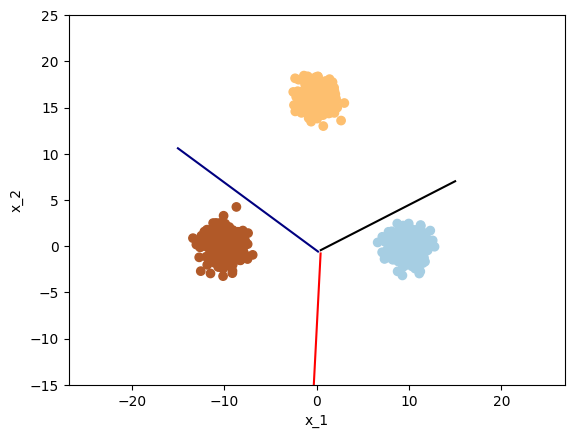

Running solver
Reading problem formulation
Asking for data information
Getting data
     10.0% of scenarios is processed
100% of matrix_scenarios was read
100% of matrix_quadratic1 was read
100% of matrix_quadratic2 was read
100% of matrix_quadratic3 was read
Start optimization
Ext.iteration=0  Objective=0.120000000000E+02  Residual=-.800000000000E+01
Ext.iteration=104  Objective=-.595624118713E+01  Residual=0.346387807326E-09
Start stage  1
Ext.iteration=0  Objective=-.205273648030E+01  Residual=0.346387807326E-09
Ext.iteration=54  Objective=-.243926397309E+01  Residual=0.335959844833E-06
Optimization is stopped
Solution is optimal
Calculating resulting outputs. Writing solution.
Objective: objective = 0.00000000000 [0.00000000000]
Solver has normally finished. Solution was saved.
Problem: problem_1, solution_status = optimal
Timing: data_loading_time = 0.52, preprocessing_time = 0.01, solving_time = 0.02
Variables: optimal_point = point_problem_1
Objective: objective = 0.00000000000 

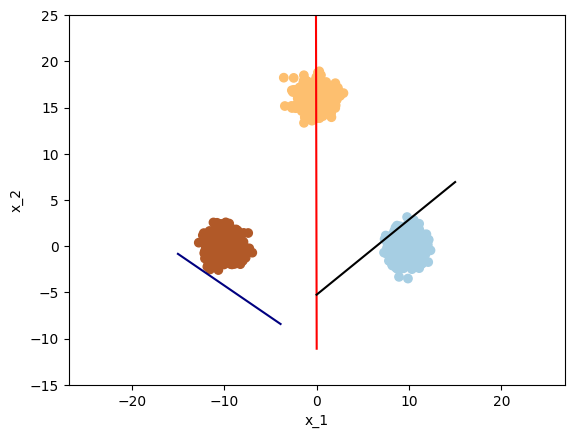

Running solver
Reading problem formulation
Asking for data information
Getting data
     10.0% of scenarios is processed
100% of matrix_scenarios was read
100% of matrix_quadratic1 was read
100% of matrix_quadratic2 was read
100% of matrix_quadratic3 was read
Start optimization
Ext.iteration=0  Objective=0.120000000000E+02  Residual=-.800000000000E+01
Ext.iteration=115  Objective=-.585492323016E+01  Residual=0.152038381884E-10
Start stage  1
Ext.iteration=0  Objective=-.235095770651E+01  Residual=0.152038381884E-10
Ext.iteration=49  Objective=-.260302123367E+01  Residual=0.299958836436E-06
Optimization is stopped
Solution is optimal
Calculating resulting outputs. Writing solution.
Objective: objective = 0.00000000000 [0.00000000000]
Solver has normally finished. Solution was saved.
Problem: problem_1, solution_status = optimal
Timing: data_loading_time = 0.52, preprocessing_time = 0.01, solving_time = 0.02
Variables: optimal_point = point_problem_1
Objective: objective = 0.00000000000 

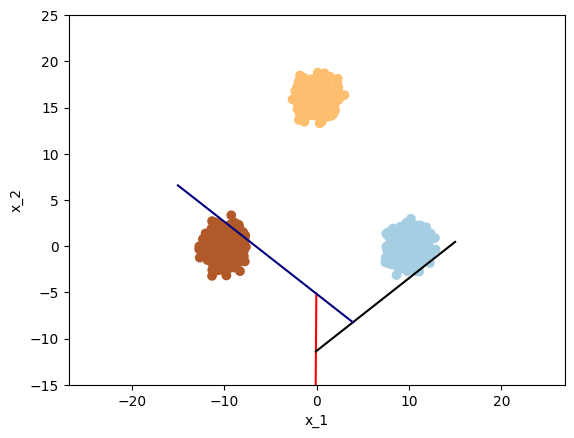

Running solver
Reading problem formulation
Asking for data information
Getting data
100% of matrix_scenarios was read
100% of matrix_quadratic1 was read
100% of matrix_quadratic2 was read
100% of matrix_quadratic3 was read
Start optimization
Ext.iteration=0  Objective=0.120000000000E+02  Residual=-.800000000000E+01
Ext.iteration=108  Objective=-.582441302279E+01  Residual=0.245585596303E-08
Start stage  1
Ext.iteration=0  Objective=-.118415160775E+01  Residual=0.245585596303E-08
Ext.iteration=61  Objective=-.196459790454E+01  Residual=0.237078772614E-06
Optimization is stopped
Solution is optimal
Calculating resulting outputs. Writing solution.
Objective: objective = 0.00000000000 [0.00000000000]
Solver has normally finished. Solution was saved.
Problem: problem_1, solution_status = optimal
Timing: data_loading_time = 0.41, preprocessing_time = 0.01, solving_time = 0.03
Variables: optimal_point = point_problem_1
Objective: objective = 0.00000000000 [0.00000000000]
Constraint: constrain

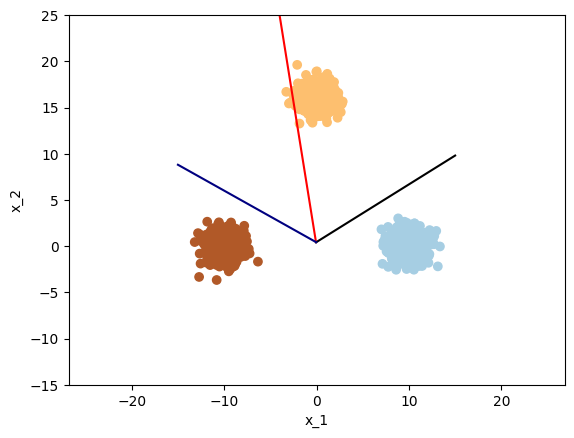

Running solver
Reading problem formulation
Asking for data information
Getting data
100% of matrix_scenarios was read
100% of matrix_quadratic1 was read
100% of matrix_quadratic2 was read
100% of matrix_quadratic3 was read
Start optimization
Ext.iteration=0  Objective=0.120000000000E+02  Residual=-.800000000000E+01
Ext.iteration=235  Objective=-.589861821818E+01  Residual=0.112468256930E-08
Start stage  1
Ext.iteration=0  Objective=-.210510325448E+01  Residual=0.112468256930E-08
Ext.iteration=51  Objective=-.243019378027E+01  Residual=0.312917967094E-06
Optimization is stopped
Solution is optimal
Calculating resulting outputs. Writing solution.
Objective: objective = 0.00000000000 [0.00000000000]
Solver has normally finished. Solution was saved.
Problem: problem_1, solution_status = optimal
Timing: data_loading_time = 0.41, preprocessing_time = 0.01, solving_time = 0.03
Variables: optimal_point = point_problem_1
Objective: objective = 0.00000000000 [0.00000000000]
Constraint: constrain

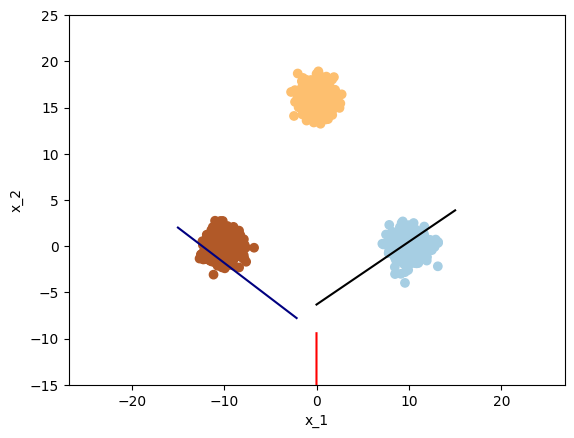

In [12]:
def find_intersection(func1, func2, x0):
    """
    Find intersection of two functions, starting from an initial guess x0.
    """
    from scipy.optimize import fsolve
    return fsolve(lambda x : func1(x) - func2(x), x0)

for i in range(5):
    p_tilda, p_star, w_tilda, w_star, a_tilda, a_star, X, y = driver(np.array([1] * 3), np.array([4,4,4]), 0.01, 'VAN', 'BULDOZER', 3)
    
    
    f1 = lambda x: (w_star[2] - w_star[0]*x)/w_star[1]
    f2 = lambda x: (w_star[5] - w_star[3]*x)/w_star[4]
    f3 = lambda x: (w_star[8] - w_star[6]*x)/w_star[7]

    # Find intersection points
    x_intersect_12 = find_intersection(f1, f2, 0)[0]
    x_intersect_13 = find_intersection(f1, f3, 0)[0]
    x_intersect_23 = find_intersection(f2, f3, 0)[0]

    # Creating x values for plotting up to the intersection points
    x_vals_1 = np.linspace(min(-15, x_intersect_13), x_intersect_13, 100)
    x_vals_2 = np.linspace(x_intersect_12, max(15, x_intersect_12), 100)
    x_vals_3 = np.linspace(min(-15, x_intersect_23), x_intersect_23, 100)

    # Plot
    plt.scatter(X[0][:, 0], X[0][:, 1], c=y[0], cmap=plt.cm.Paired)
    plt.plot(x_vals_1, f1(x_vals_1), c='red')
    plt.plot(x_vals_2, f2(x_vals_2), c='black')
    plt.plot(x_vals_3, f3(x_vals_3), c='navy')
    plt.xlabel('x_1')
    plt.ylabel('x_2')
    plt.axis('equal')
    plt.xlim(-10, 10)
    plt.ylim(-15, 25)
    plt.show()